## 112 DENSITY ALGORITHMS

In [1]:
# for data
import pandas as pd
import numpy as np

# for geospatial
import geopandas as gpd
import geojson

# for viz
import seaborn as sns
import matplotlib.pyplot as plt

%matplotlib inline
sns.set_style("darkgrid", {"axes.facecolor": ".8"})

## DEF AND GLOBAL VARIABLES

In [5]:
# GLOBAL variables
CLEAN_PATH = '../data/clean' # transform this into temp file

MODEL_PATH = '../data/modelbase'
LABELLED_PATH = '../data/labelled'

FILE_TO_MODEL = 'all_data.geojson'

NAMES_DICT = {
    
    'build_gdf': 'bu_point',
    'arturo_gdf': 'qlity_mdl',
    'madrid_gdf': 'madrid_gdf'
}

MADRID_EPSG = 25830
STATE = 42

 OPENING DATA 


In [6]:
# Opening and naming of ALL DATA
madrid_gdf = gpd.read_file(f"{MODEL_PATH}/{FILE_TO_MODEL}")
madrid_gdf.name = NAMES_DICT['madrid_gdf']
madrid_gdf.set_index('ID', inplace = True)

In [7]:
# columns
# bool_cols = madrid_gdf.columns.tolist()[]
num_cols = madrid_gdf.columns.tolist()[2:62]
geom_col = madrid_gdf.columns.tolist()[63]
cat_cols = ['centuryOfConstr', 'currentUse', 'conditionOfConstruction']

In [8]:
madrid_gdf.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 121004 entries, 0003405VK4700C to 9997707VK3899F
Data columns (total 64 columns):
 #   Column                         Non-Null Count   Dtype   
---  ------                         --------------   -----   
 0   conditionOfConstruction        121004 non-null  object  
 1   currentUse                     121004 non-null  object  
 2   n_BuildingUnits                121004 non-null  int64   
 3   n_Dwellings                    121004 non-null  int64   
 4   nFloors_AG                     121004 non-null  int64   
 5   nFloors_BG                     121004 non-null  int64   
 6   area_m2c                       121004 non-null  int64   
 7   area_m2p                       121004 non-null  int64   
 8   train                          121004 non-null  float64 
 9   land_use_mix                   121004 non-null  float64 
 10  closeness_small_parks          121004 non-null  float64 
 11  residence_ratio                121004 non-null  float6

 At this points, there shouldn't be anything else to do to this data

## 1
### PREPROCESSING FOR NUMERIC COLUMNS

In this case, all features are **numeric**, since categorical feature have already been converted to dummies.
Therefore, only standization / normalization is needed

In [9]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
# Standarization --> rescaling to mean == 0 and Std.Dev == 1

# cols to select
num_df = scaler.fit_transform(madrid_gdf.reset_index()[num_cols])

# Getting dummies and dropping cols
cat_df = pd.get_dummies(madrid_gdf[cat_cols])

display(num_df.shape)
display(cat_df.shape)

(121004, 60)

(121004, 19)

In [11]:
# ADD BOOL COLS
madrid_aux = pd.concat([pd.DataFrame(num_df, columns = num_cols), 
                       cat_df.reset_index()], axis = 1)

madrid_scaled = pd.DataFrame(madrid_aux)

madrid_scaled['ID'] = madrid_gdf.reset_index()['ID']
madrid_scaled.set_index('ID', inplace = True)

# madrid_scaled['geometry'] = madrid_gdf['geometry'] 
# add geometry if needed

display(madrid_scaled.head())
display(madrid_scaled.shape)

,n_BuildingUnits,n_Dwellings,nFloors_AG,nFloors_BG,area_m2c,area_m2p,train,land_use_mix,closeness_small_parks,residence_ratio,...,centuryOfConstr_21-01,currentUse_agriculture,currentUse_industrial,currentUse_office,currentUse_publicServices,currentUse_residential,currentUse_retail,conditionOfConstruction_declined,conditionOfConstruction_functional,conditionOfConstruction_ruin
ID,,,,,,,,,,,,,,,,,,,,,
0003405VK4700C,0.087800,0.235904,0.514011,0.679774,0.039828,-0.052545,-0.618935,-0.102160,0.020845,0.593430,...,0,0,0,0,0,1,0,0,1,0
0003408VK4700C,-0.087807,0.028907,-0.215761,-0.710403,-0.138108,-0.065443,1.029568,0.534799,0.020845,1.061849,...,0,0,0,0,0,1,0,0,1,0
0003801VK4700C,-0.373169,-0.509287,-1.310419,-0.710403,-0.305532,-0.101728,2.678071,-0.443537,0.020845,0.224812,...,0,0,1,0,0,0,0,0,1,0
0003804VK4700C,-0.373169,-0.509287,-1.310419,-0.710403,-0.305532,-0.101728,-0.618935,0.026897,-0.328684,0.916099,...,0,0,1,0,0,0,0,0,1,0
0003805VK4700C,-0.219512,-0.178091,0.149125,-0.710403,-0.209530,-0.094783,-0.618935,0.026897,-0.328684,0.916099,...,0,0,0,0,0,1,0,0,1,0


(121004, 79)

## 2
### PCA - DIMENSION REDUCTION

One problem of this dataset is the high number of features (80columns) because:
>- Makes the training very slow
>- Makes it difficult to find a good solution

This is known as the curse of dimensionality and the Dimensionality Reduction is the process of reducing the number of features to the most relevant ones in simple terms.

Reducing dimensionality does lose some information, however as most compressing processes it comes with some drawbacks, even though we get the training faster, we make the system perform slighly worse, but this is ok, because it can filter some of the noise and unnecesary details present in the dataset.

There are two main approaches to dimension reduction:
>- **PROJECTION**: PCA
>- **MANIFOLD LEARNING**: Relies on the hypothesis which holds that most real-world high-dimensional datasets lie close to a much lower-dimensional manifold.

#### 2.1 Lets use PCA (Principal Component Analysis) to analyze the most sitable dimension for geodata features

This technique works by identifying the hyperplane which lies closest to the data and then projects the data on that hyperplane while retaining most of the variation in the dataset.

Drawbacks: 
>- It is highly influenced by outliers present in the data
>- It is a linear projection, which means it can't capture non-linear dependencies.

In [12]:
from sklearn.decomposition import PCA

geodata_pca = PCA().fit(madrid_scaled)

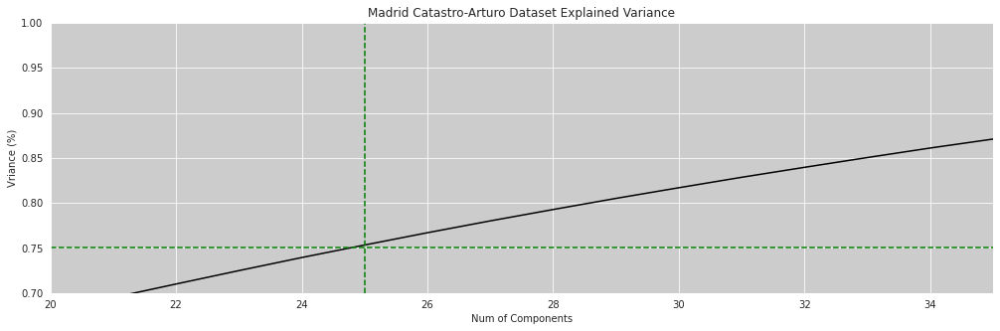

In [13]:
plt.figure(figsize=(17,5))
plt.plot(np.cumsum(geodata_pca.explained_variance_ratio_), c = 'k')
plt.axhline(0.75, ls = '--', c = 'g')
plt.axvline(25, ls = '--', c = 'g')

plt.xlabel('Num of Components')
plt.ylabel('Vriance (%)')
plt.title('Madrid Catastro-Arturo Dataset Explained Variance')

plt.ylim([0.70 ,1])
plt.xlim([20,35])
plt.show()

   The plot shows that selecting 25 components, I can preserve around 75% of the total variance of the data. It makes sence not to usse the 100% of our variance, because it denotes all components and we want only the principal ones.
   
*NOTE______

Losing less variance makes clustering far much difficult. There is a compromise between variance and uniformity of clusters to be made and after consideration from 10 components to 45 components comparison, 25 seems a fine reduction

#### 2.2 Lets use UMAP (Uniform Manifold Approximation and Projection)

Is a general-purpose manifold learning and dimension reduction algorithm created in 2018 by Leland McInnes, John Healy, James Melville. It is a nonlinear dimensionality reduction method and is very effective for visualizing clusters or groups of data points and their relative proximities.

It doesn't require PCA as a prior pre-processing step in the case of sparse matrices, like in the case of t-SNE, which is another -very similar- dim.red. method.

HYPERPARAMETERS that have an impact on the resulting embeddings:
>- **n_neighbors**: how balanced local vs. global structure in the data.
    * Low values: forces UMAP to focus on very local structures
    * High values: forces UMAP to focus on the larger neighbourhoods.

>- **min_dist**: controls how tightly UMAP is allowed to pack points together.
    * Low values: points will be clustered closely
    * High values: points will be clustered sparingly
    
>- **n_components**: determine the dimensionality of the reduced dimension space
>- **metric**: how distance is computed in the ambient space of the input data.

[link doc](https://umap-learn.readthedocs.io/en/latest/parameters.html?highlight=metric#metric)

In [14]:
import umap

reducer_geodata = umap.UMAP(random_state = STATE,
                            verbose = True,
                            learning_rate = 0.9, # tune
                            metric = 'correlation', # default euclidean
                            n_neighbors = 25,  # default 15
                            n_components = 25, # since from PCA 9 componentes losses around 0.01% of info and normal gdf w elbow is 24
                            repulsion_strength = 5,
                            local_connectivity = 1.25, #local connectivity constraint ensures that we focus on the difference in distances among nearest neighbors rather than the absolute distance
                            min_dist = 0.0005 # default 0.1 lower val for clustering
                            )

reducer_geodata.fit(madrid_scaled)
madrid_umap = reducer_geodata.transform(madrid_scaled)

# NOTES _________________
# Params with the most influence on this dataset:
# n_neighbors, n_components -> rely a lot on knowledge of the dataset
# min_dist -> makes the clustering 2D representation far more clearer
# metric -> cosine and euclidean give an error


UMAP(angular_rp_forest=True, learning_rate=0.9, local_connectivity=1.25,
     metric='correlation', min_dist=0.0005, n_components=25, n_neighbors=25,
     random_state=42, repulsion_strength=5, verbose=True)
Construct fuzzy simplicial set
Sat Oct 24 12:57:39 2020 Finding Nearest Neighbors
Sat Oct 24 12:57:39 2020 Building RP forest with 22 trees
Sat Oct 24 12:57:42 2020 NN descent for 17 iterations
	 0  /  17
	 1  /  17
	 2  /  17
	 3  /  17
	 4  /  17
	 5  /  17
Sat Oct 24 12:58:10 2020 Finished Nearest Neighbor Search
Sat Oct 24 12:58:14 2020 Construct embedding
	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Sat Oct 24 13:00:18 2020 Finished embedding


Text(0.5, 1.0, 'Geodata Embedding projection')

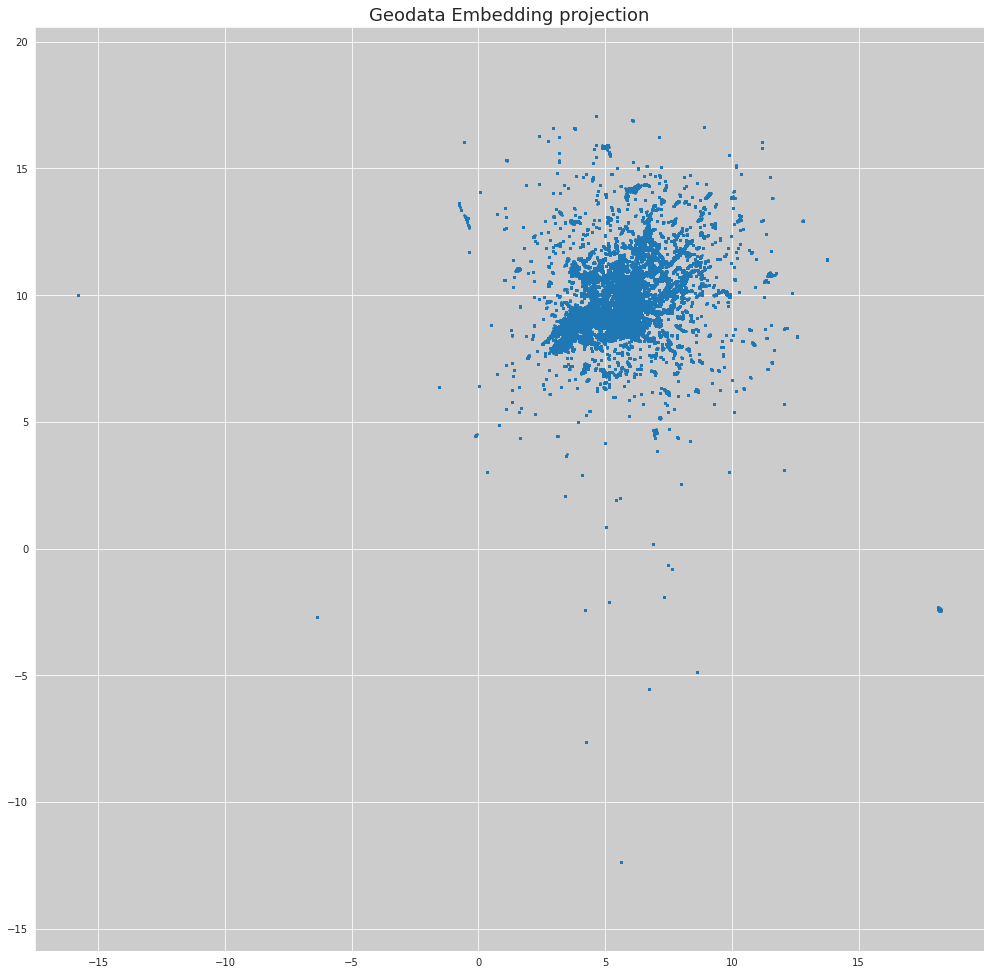

In [15]:
plt.figure(figsize = (17,17))
plt.scatter(x = madrid_umap[:, 0], 
            y = madrid_umap[:, 1], 
            s =3)

plt.gca().set_aspect('equal', 'datalim')
plt.title('Geodata Embedding projection', fontsize=18)

## 4
#### DENSITY BASED CLUSTERING: DBSCAN

Works by grouping regions of high density and separating them from regions of low density. 
Most famous algorith is DBSCAN. Density is calculated as follows:
>- EPS: defines the neighborhood around the data point:
     If the dist between 2Pts is <= EPS --> they are neighbors
 >- MinPTs: minimum number of data Pts that form a neighborhood. Size of DF and value of MinPts are directly proportional.
 
 Mostly used for clustering planar space.
 Good result can be achieved if it is used for mapping: natural disasters, weather stations in a city.
 DBSCAN can be seen also as a special and efficient variant of spectral clustering, being a non-matrix based implementation that only needs o(n) memory

**WITH UMAP** 
(clusters with low variance)
WORKS WITH UMAP not with PCA

In [16]:
from sklearn.cluster import DBSCAN

dbscan_model = DBSCAN(eps = 1.25,
                      min_samples = 150,
                      n_jobs = 10).fit(madrid_umap)

# EPS 1.25 + MIN_SAMPLES 150 --> arround 80-85

In [17]:
np.array(dbscan_model.labels_).max() # how many labels are there? should be 80-85 clusters

86

In [18]:
from sklearn import metrics

### Metrics
dbscan_model_var = metrics.calinski_harabasz_score(madrid_umap, 
                                               dbscan_model.labels_)
display(dbscan_model_var)

dbscan_model_db = metrics.davies_bouldin_score(madrid_umap, 
                                           dbscan_model.labels_)
display(dbscan_model_db)

## 1660-1.33

1642.1148525028627

1.3351419942009595

In [19]:
## SILHOUETTE METRIC at last
## Separated because of computing time
dbscan_model_silh = metrics.silhouette_score(madrid_umap, 
                                         dbscan_model.labels_)
display(dbscan_model_silh)

## 0.157-0.167

/home/lucia/miniconda3/envs/geoesp_env/lib/python3.7/site-packages/sklearn/metrics/pairwise.py:320: RuntimeWarning: invalid value encountered in sqrt
  return distances if squared else np.sqrt(distances, out=distances)


0.19356228

In [20]:
import joblib

# save the model to disk

filename = f'model_dbscan_silh{int(dbscan_model_silh*1000)}.sav'
joblib.dump(dbscan_model, filename)

# load the model from disk

# loaded_model = joblib.load(filename)

['model_dbscan_silh193.sav']

In [22]:
madrid_gdf['dbscan_labels']= dbscan_model.labels_.tolist()

col_to_draw = 'dbscan_labels' # col value corresponds grossfloorarea
madrid_gdf[['geometry', col_to_draw]].plot(figsize = (150,150), 
                                           column = col_to_draw, 
                                           legend = False,
                                           cmap = 'seismic')
plt.show()

### ANALYSIS OF RESULTS

Lets see how both algorithms have behaved

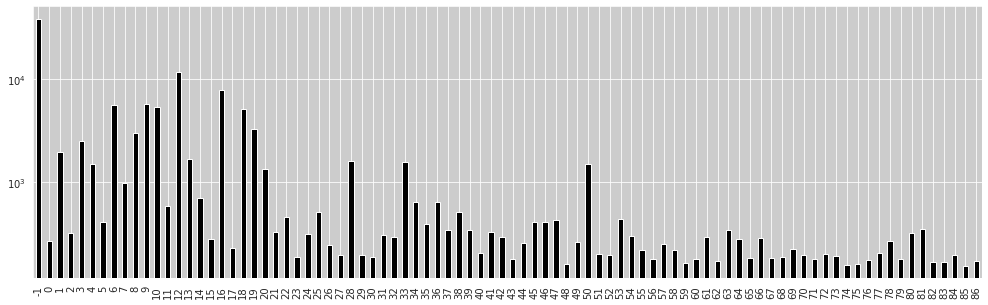

Min values in labels: 151


In [23]:
madrid_gdf['dbscan_labels'].value_counts().sort_index().plot.bar(figsize = (17,5), color = 'k').set_yscale("log")
plt.show()

print(f"Min values in labels: {madrid_gdf['dbscan_labels'].value_counts().min()}")

In [24]:
## Let's do another dataframe with scaled data in order to viz relevance of cols
madrid_lbl = pd.concat([madrid_scaled, madrid_gdf['dbscan_labels']],axis = 1)

## 
more_important_cols = ['value', 'street_centrality_degree', 'residence_ratio', 'closeness_large_parks', 
                       'closeness_primary_roads', 'street_hierarchy_secondary', 'n_BuildingUnits', 
                       'nFloors_AG', 'centuryOfConstr_19-02', 'train', 'commerce_surface',                     
                       'age_deviation_diversity', 'leisure_density', 'housing_surface', 
                      'tertiary_roads_length',  'closeness_secondary_roads', 'average_quality', 
                       'average_age', 'centuryOfConstr_20-02', 'centuryOfConstr_21-01', 'anisotropicity', 
                       'street_hierarchy_primary', 'currentUse_residential', 
                      'conditionOfConstruction_functional', 'conditionOfConstruction_declined']


table_km_model = pd.pivot_table(madrid_lbl,
                                values = more_important_cols,
                                index = 'dbscan_labels',
                                aggfunc = np.mean)

table_km_model.sort_values(by = 'value', inplace = True)
table_km_model

,age_deviation_diversity,anisotropicity,average_age,average_quality,centuryOfConstr_19-02,centuryOfConstr_20-02,centuryOfConstr_21-01,closeness_large_parks,closeness_primary_roads,closeness_secondary_roads,...,leisure_density,nFloors_AG,n_BuildingUnits,residence_ratio,street_centrality_degree,street_hierarchy_primary,street_hierarchy_secondary,tertiary_roads_length,train,value
dbscan_labels,,,,,,,,,,,,,,,,,,,,,
52,-0.156450,-0.089918,0.341466,0.090656,0.000000,0.557292,0.291667,0.365870,-0.059972,0.789670,...,-0.564493,-0.977840,-0.366080,-1.179641,1.863000,-0.073564,-0.381070,-0.882280,-0.307408,-1.870334
36,-0.497876,1.491446,-0.076675,-0.434115,0.001575,0.694488,0.206299,-0.233947,-4.553737,-0.126168,...,-0.545253,0.030178,0.152166,-0.774147,-0.660939,10.860985,-0.209329,3.092224,-0.387014,-1.509752
8,-0.339340,1.535038,-0.434868,-0.704332,0.010579,0.641322,0.277686,-0.071252,-0.767430,-0.424972,...,-0.532561,-0.310571,-0.185371,-1.604413,-0.519006,0.010380,0.261538,0.248393,-0.352015,-1.320880
49,-0.216026,-0.142556,0.293414,-0.136187,0.000000,0.305882,0.615686,0.365870,0.246861,0.804008,...,-0.671909,-0.772391,-0.364991,-0.157120,1.580051,-0.073564,-0.387331,-0.704559,-0.370151,-1.225990
19,0.199729,-0.230705,0.300535,0.248864,0.025406,0.545455,0.169881,0.353087,0.277577,0.648244,...,-0.212444,-0.292156,-0.153687,0.364325,0.511282,-0.073564,-0.379384,-0.455651,-0.075225,-1.037526
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
57,1.754017,-0.242908,-1.773337,0.217940,0.000000,0.108871,0.036290,0.365870,0.239300,0.356967,...,-0.712798,-0.717479,-0.368920,-1.267696,0.401793,-0.073564,0.124654,-0.002512,-0.082608,0.944729
54,1.069741,0.056680,-0.831024,-1.017888,0.020270,0.341216,0.013514,-1.096492,0.277680,-1.967527,...,0.447365,1.249946,0.088542,0.212532,0.147878,-0.073564,1.877303,0.904865,-0.049016,1.266258
11,1.415365,-0.101604,-1.514093,-1.153948,0.475043,0.189329,0.029260,0.240735,0.275805,-0.212944,...,1.629924,0.500822,0.047110,0.834262,0.411546,-0.073564,-0.035563,0.324468,1.488905,1.493370


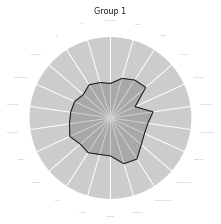

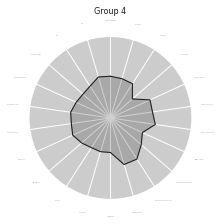

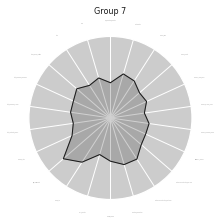

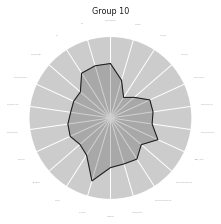

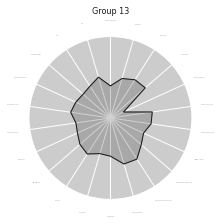

...

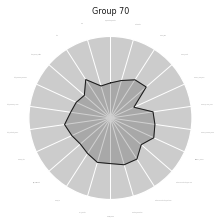

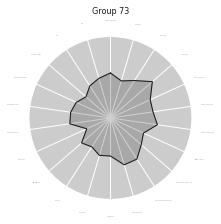

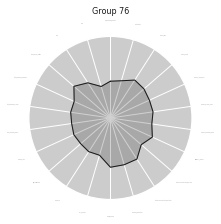

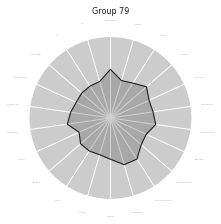

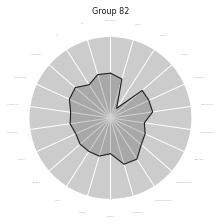

In [222]:
from math import pi 
   
def make_spider_plot(row, title, color):
    """
    Make custom polar plot for every label
    """
    # number of variable
    categories = table_km_model.columns.tolist()
    N = len(categories)

    # What will be the angle of each axis in the plot? (we divide the plot / number of variable)
    angles = [n / float(N) * 2 * pi for n in range(N)]
    angles += angles[:1]    # first value to close the circular graph

    ########
    plt.figure(figsize = (3,3))
    ax = plt.subplot(1,1,1, polar=True)

    # If you want the first axis to be on top:
    ax.set_theta_offset(pi / 2)
    ax.set_theta_direction(-1)

    # Draw one axe per variable + add labels labels yet
    plt.xticks(angles[:-1], categories, color='grey', size = 0)

    # Draw ylabels
    ax.set_rlabel_position(0)
    plt.yticks([10,20,30], ["10","20","30"], color="grey", size=7)
    plt.ylim(-5.00, 5.00)

    #######
    # We are going to plot the first line of the data frame.
    values = table_km_model.loc[row].values.flatten().tolist() 
    values += values[:1]  # first value to close the circular graph
        
    # Plot data
    ax.plot(angles, values, linewidth=1, linestyle='solid', color = color)
    ax.fill(angles, values, color = color, alpha=0.20) # Fill area
    
    #######
    # Add a title
    plt.title(title, size = 8, color = color, y = 1.1)
    plt.show()
    

for row in range(0, table_km_model.shape[0],3):
    make_spider_plot(row = row, 
                     title = f'Group {row+1}',
                     color = 'k')

In [25]:
# OPENING POLYGONS FILE
madrid_polygons = gpd.read_file(f"{CLEAN_PATH}/building_polygon.geojson")
madrid_polygons.set_index('ID')

madrid_labelled_polygons = gpd.GeoDataFrame(madrid_lbl,
                                            geometry = madrid_polygons.set_index('ID')['geometry'])

/home/lucia/miniconda3/envs/geoesp_env/lib/python3.7/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)


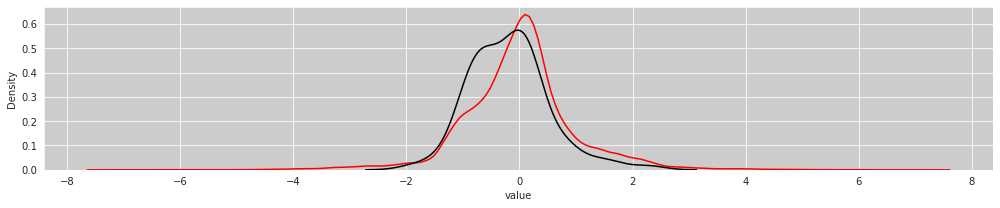

In [26]:
table = pd.pivot_table(madrid_labelled_polygons.reset_index(),
                       values = 'value',
                       index = 'dbscan_labels',
                       aggfunc = np.mean)

# does distribution change?
fig, ax = plt.subplots(ncols = 1, nrows = 1, figsize = (17,3))

sns.kdeplot(data = madrid_labelled_polygons, x = 'value', ax = ax, color = 'red')
sns.distplot(table, kde = True, hist = False, ax = ax, color = 'k')

plt.show()

In [27]:
# Let's reorder columns in acordance to its mean-value
table.sort_values(by = 'value', inplace = True)
table.reset_index(inplace = True); table.reset_index(inplace = True)

table.rename(columns = {'index': 'clusters_all'}, inplace = True)

# def of change
def change_label(val):
    return table[table['dbscan_labels'] == val]['clusters_all'].values.tolist()[0]

change_label_vectorize = np.vectorize(change_label) # val to --> ser/array

In [28]:
# lets add a new columns with labels orderer
madrid_labelled_polygons['cluster_all'] = change_label_vectorize(madrid_labelled_polygons['dbscan_labels'])
madrid_gdf['cluster_all'] = change_label_vectorize(madrid_gdf['dbscan_labels'])

In [220]:
display(madrid_gdf[['geometry', 'dbscan_labels', 'cluster_all']].head(1)) # madrid_labelled_points
display(madrid_labelled_polygons[['geometry', 'dbscan_labels', 'cluster_all']].head(1))

,geometry,dbscan_labels,cluster_all
ID,,,
0003405VK4700C,POINT (439952.320 4470136.260),0,30


,geometry,dbscan_labels,cluster_all
ID,,,
0003405VK4700C,"POLYGON ((439954.172 4470156.143, 439955.903 4...",0,30


In [29]:
col_to_draw = 'cluster_all'

madrid_labelled_polygons[['geometry', col_to_draw]].plot(figsize = (150,150), 
                                                         column = col_to_draw, 
                                                         legend = False, 
                                                         cmap = 'seismic')
plt.show()

In [31]:
# Sabe labelled files
madrid_gdf[['cluster_all']].to_csv(f"{LABELLED_PATH}/all_labels.csv")